In [1]:
import rclpy
from rclpy.node import Node
from nimbro_robot import robot as robot
from nimbro_utils.node import WaitForMessage
from cv_bridge import CvBridge
from matplotlib import pyplot as plt
import numpy as np
from sensor_msgs.msg import Image
import time

from geometry_msgs.msg import Pose
import cv2
import os

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
%load_ext autoreload
%autoreload 2

import fiftyone as fo
import fiftyone.zoo as foz
from fiftyone import ViewField as F

import torch
import detectron2
from detectron2.utils.logger import setup_logger

setup_logger()

# import some common libraries
import numpy as np
import os, shutil, json, random, cv2
from datetime import datetime
import skimage.io as io

import sys
sys.path.append("../MaskDINO")
sys.path.insert(0, "../MaskDINO/lib/python3.8/site-packages/")

# import some common detectron2 utilities
from detectron2.structures import BoxMode
from detectron2 import model_zoo
#from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.projects.deeplab import add_deeplab_config
#from detectron2.data.datasets import register_coco_instances

from helpers.util import get_timestamp, select_classes, merge_to_superclass, concat_datasets, make_archive
from helpers.fiftyone_detectron2_bridge import clean_instances, detectron_to_fo, get_fiftyone_dicts
from helpers.config import add_config


In [3]:
rclpy.init()
r = robot.Robot('lidar')

[INFO] [1708710711.553415807] [lidar]: [parameter_handler] Parameter 'logger_level' initialized to '20'
[INFO] [1708710711.554453824] [lidar]: [parameter_handler] Parameter 'logger_prefix' initialized to '[robot] '
[INFO] [1708710711.555264272] [lidar]: [parameter_handler] Parameter 'logger_speech' initialized to 'False'
[INFO] [1708710711.555675730] [lidar]: [parameter_handler] Parameter 'gui_topic_text' initialized to '/nimbro_gui/text'
[INFO] [1708710711.556057945] [lidar]: [parameter_handler] Parameter 'gui_topic_speech' initialized to '/nimbro_gui/recognized_speech'
[INFO] [1708710711.556404995] [lidar]: [parameter_handler] Parameter 'map_topic_initial_pose' initialized to '/initialpose'
[INFO] [1708710711.556756514] [lidar]: [parameter_handler] Parameter 'base_twist_topic' initialized to '/mobile_base_controller/cmd_vel'
[INFO] [1708710711.557116013] [lidar]: [parameter_handler] Parameter 'camera_eye_topic_rgb' initialized to '/xtion/rgb/image_rect_color'
[INFO] [1708710711.55746

In [4]:
import maskdino

cfg = get_cfg()
add_deeplab_config(cfg)
add_config(cfg)

cfg.merge_from_file('include/swin_config.yaml')
#cfg.MODEL.WEIGHTS = "include/1_class_0.97.pth"
cfg.MODEL.WEIGHTS = "include/3_classes_0.92_unfrozen.pth" 
#cfg.MODEL.SEM_SEG_HEAD.NUM_CLASSES = 1
cfg.MODEL.SEM_SEG_HEAD.NUM_CLASSES = 3
cfg.MODEL.PIXEL_MEAN = [125.02593479,  58.33375975, 115.78446252, 234.51154039]
cfg.MODEL.PIXEL_STD = [51.89104605, 76.6960031,  74.260651,   16.82153164]
cfg.MODEL.CHANNELS = [0,1,2,3]

In [5]:
topics = ['signal_image', 'range_image', 
          'nearir_image', 'reflec_image']

qos_policy = rclpy.qos.QoSProfile(reliability=rclpy.qos.ReliabilityPolicy.BEST_EFFORT,
                                          history=rclpy.qos.HistoryPolicy.KEEP_LAST,
                                          depth=1)

In [6]:
from helpers.model_trainer import Predictor
predictor = Predictor(cfg)

/home/nimbro_home/.local/lib/python3.8/site-packages/torch/functional.py:505: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


criterion.weight_dict  {'loss_ce': 4.0, 'loss_mask': 5.0, 'loss_dice': 5.0, 'loss_bbox': 5.0, 'loss_giou': 2.0, 'loss_ce_interm': 4.0, 'loss_mask_interm': 5.0, 'loss_dice_interm': 5.0, 'loss_bbox_interm': 5.0, 'loss_giou_interm': 2.0, 'loss_ce_dn': 4.0, 'loss_mask_dn': 5.0, 'loss_dice_dn': 5.0, 'loss_bbox_dn': 5.0, 'loss_giou_dn': 2.0, 'loss_ce_interm_dn': 4.0, 'loss_mask_interm_dn': 5.0, 'loss_dice_interm_dn': 5.0, 'loss_bbox_interm_dn': 5.0, 'loss_giou_interm_dn': 2.0, 'loss_ce_0': 4.0, 'loss_mask_0': 5.0, 'loss_dice_0': 5.0, 'loss_bbox_0': 5.0, 'loss_giou_0': 2.0, 'loss_ce_interm_0': 4.0, 'loss_mask_interm_0': 5.0, 'loss_dice_interm_0': 5.0, 'loss_bbox_interm_0': 5.0, 'loss_giou_interm_0': 2.0, 'loss_ce_dn_0': 4.0, 'loss_mask_dn_0': 5.0, 'loss_dice_dn_0': 5.0, 'loss_bbox_dn_0': 5.0, 'loss_giou_dn_0': 2.0, 'loss_ce_interm_dn_0': 4.0, 'loss_mask_interm_dn_0': 5.0, 'loss_dice_interm_dn_0': 5.0, 'loss_bbox_interm_dn_0': 5.0, 'loss_giou_interm_dn_0': 2.0, 'loss_ce_1': 4.0, 'loss_mask_1':

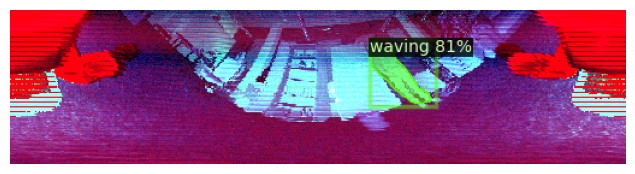

images_detection/3_classes/waving/image_0.png


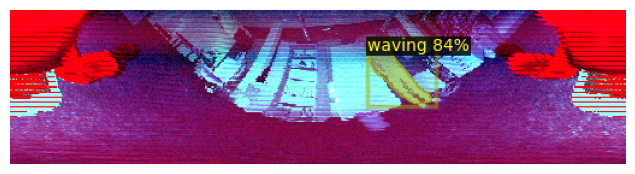

images_detection/3_classes/waving/image_1.png


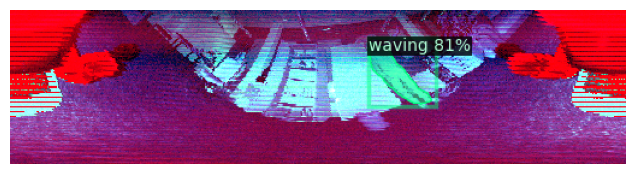

images_detection/3_classes/waving/image_2.png


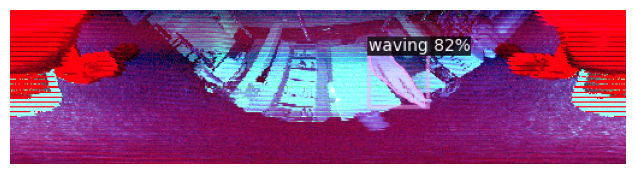

images_detection/3_classes/waving/image_3.png


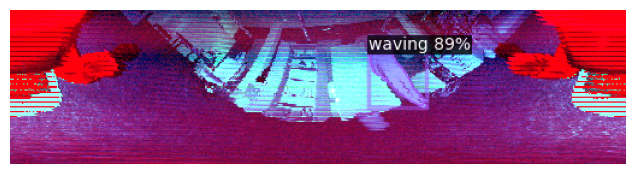

images_detection/3_classes/waving/image_4.png


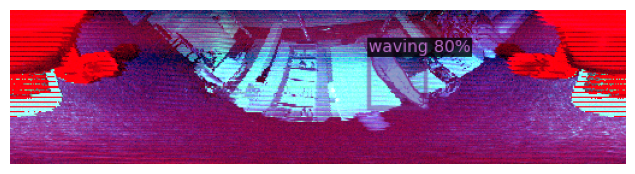

images_detection/3_classes/waving/image_5.png


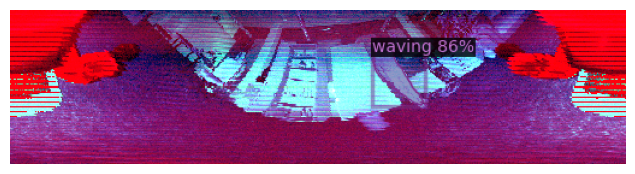

images_detection/3_classes/waving/image_6.png


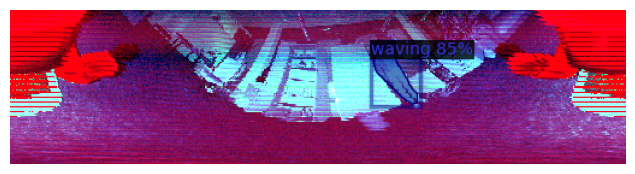

images_detection/3_classes/waving/image_7.png


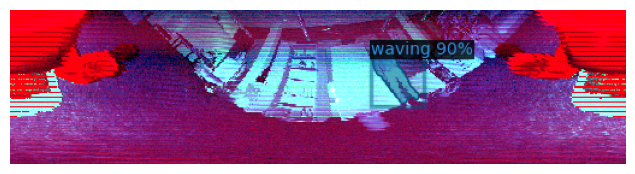

images_detection/3_classes/waving/image_8.png


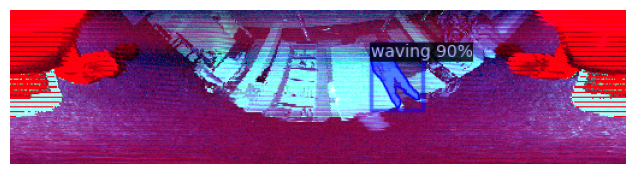

images_detection/3_classes/waving/image_9.png


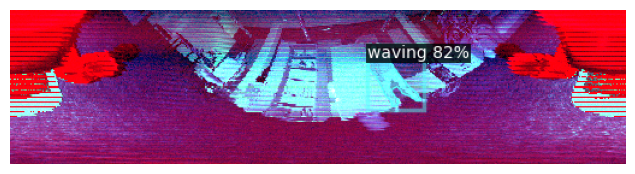

images_detection/3_classes/waving/image_10.png


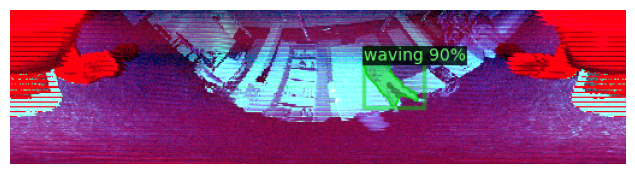

images_detection/3_classes/waving/image_11.png


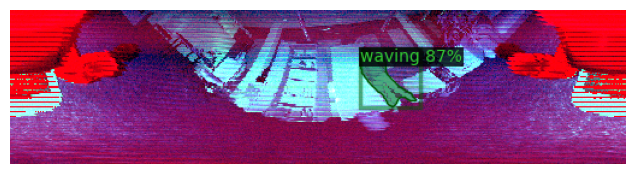

images_detection/3_classes/waving/image_12.png


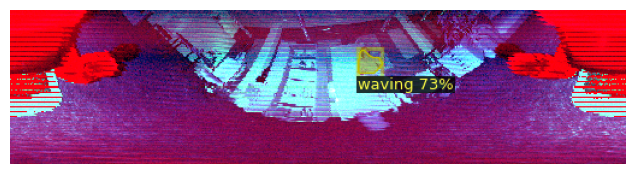

images_detection/3_classes/waving/image_13.png


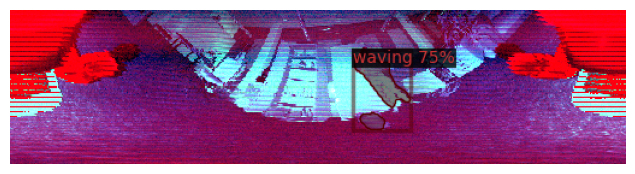

images_detection/3_classes/waving/image_14.png


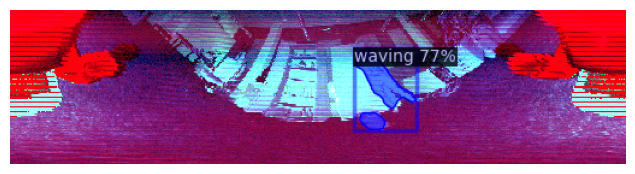

images_detection/3_classes/waving/image_15.png


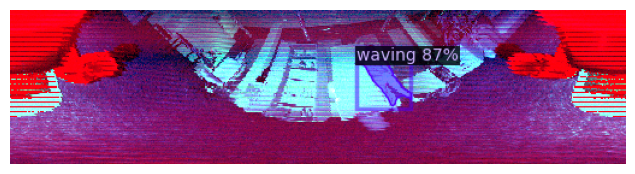

images_detection/3_classes/waving/image_16.png


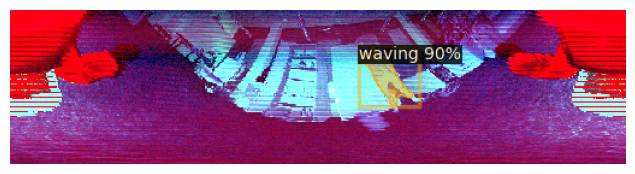

images_detection/3_classes/waving/image_17.png


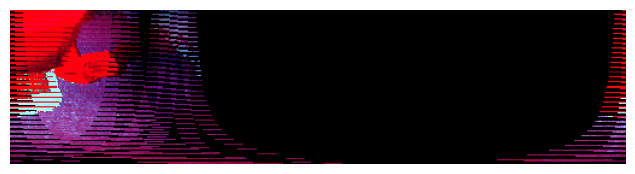

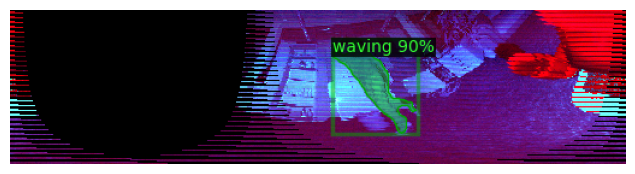

images_detection/3_classes/waving/image_18.png


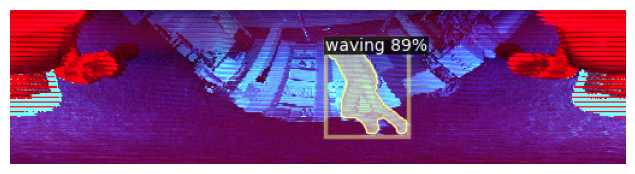

images_detection/3_classes/waving/image_19.png


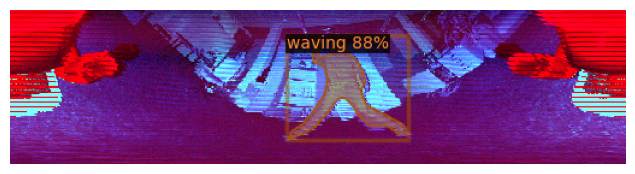

images_detection/3_classes/waving/image_20.png


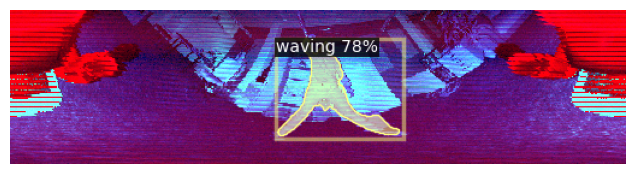

images_detection/3_classes/waving/image_21.png


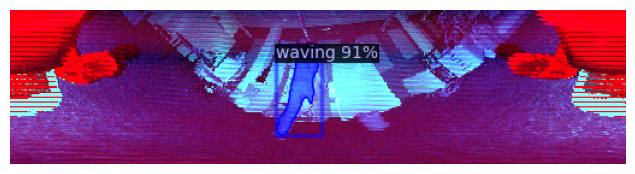

images_detection/3_classes/waving/image_22.png


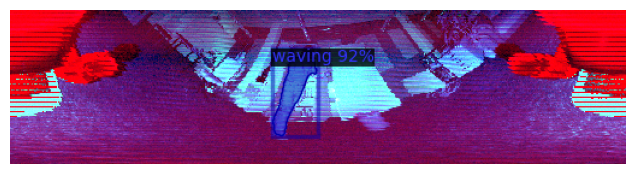

images_detection/3_classes/waving/image_23.png


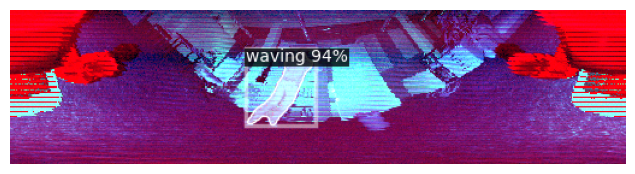

images_detection/3_classes/waving/image_24.png


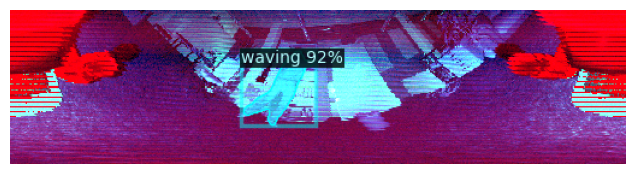

images_detection/3_classes/waving/image_25.png


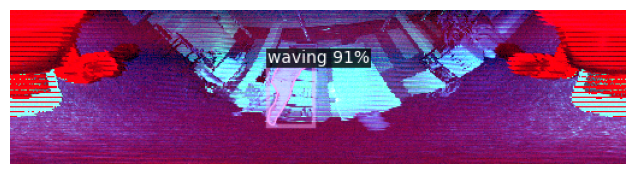

images_detection/3_classes/waving/image_26.png


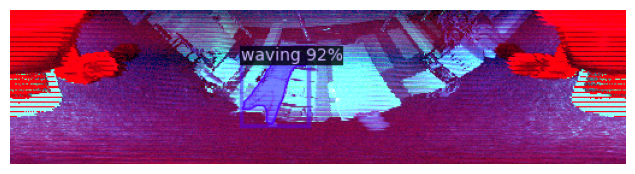

images_detection/3_classes/waving/image_27.png


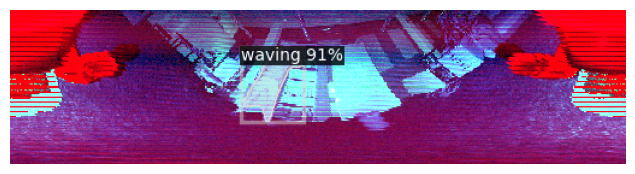

images_detection/3_classes/waving/image_28.png


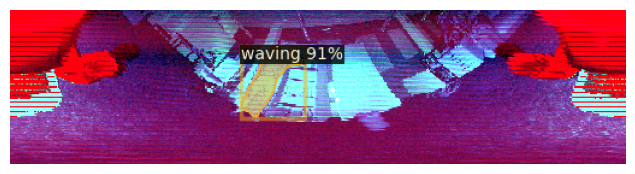

images_detection/3_classes/waving/image_29.png


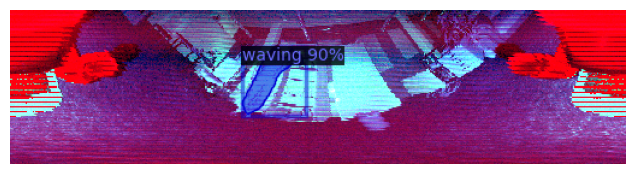

images_detection/3_classes/waving/image_30.png


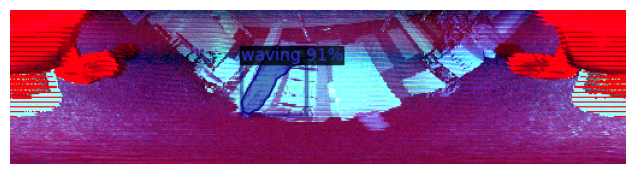

images_detection/3_classes/waving/image_31.png


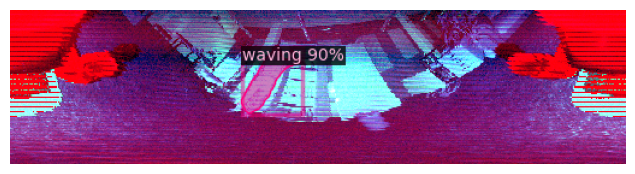

images_detection/3_classes/waving/image_32.png


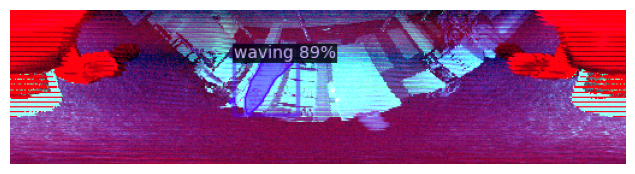

images_detection/3_classes/waving/image_33.png


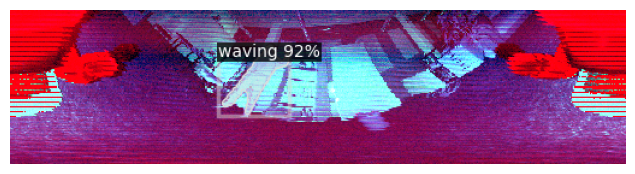

images_detection/3_classes/waving/image_34.png


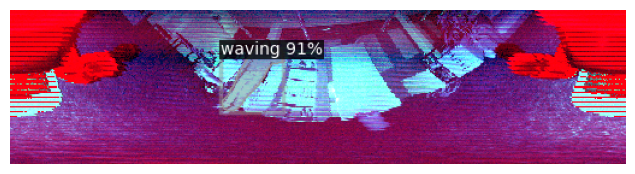

images_detection/3_classes/waving/image_35.png


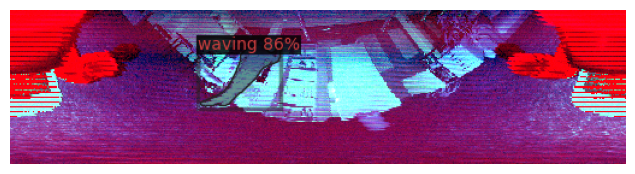

images_detection/3_classes/waving/image_36.png


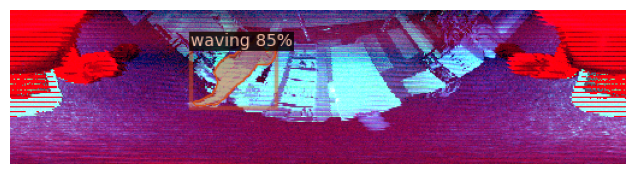

images_detection/3_classes/waving/image_37.png


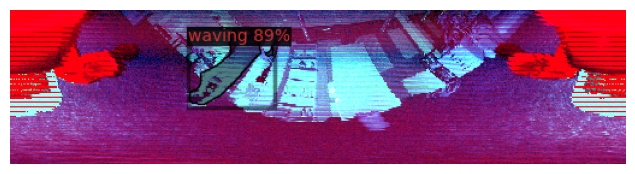

images_detection/3_classes/waving/image_38.png


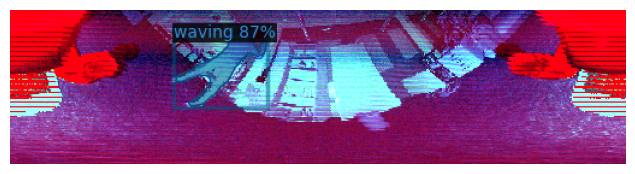

images_detection/3_classes/waving/image_39.png


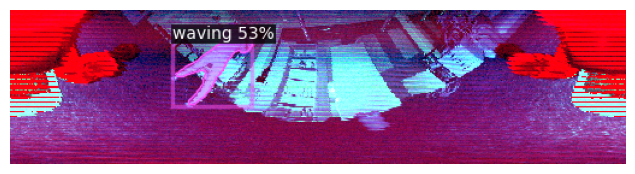

images_detection/3_classes/waving/image_40.png


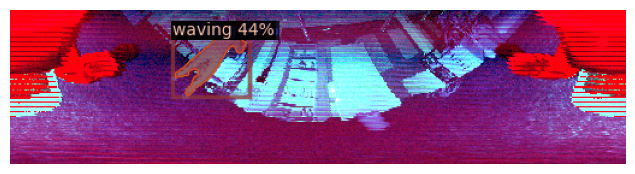

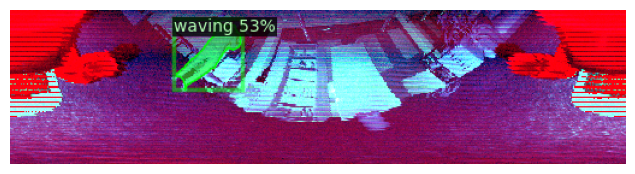

images_detection/3_classes/waving/image_41.png


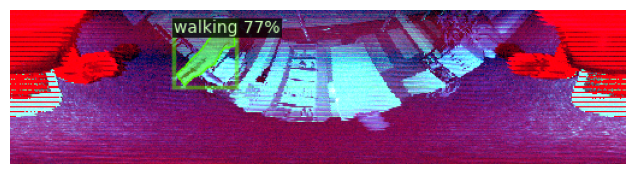

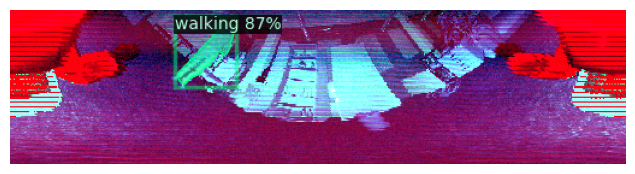

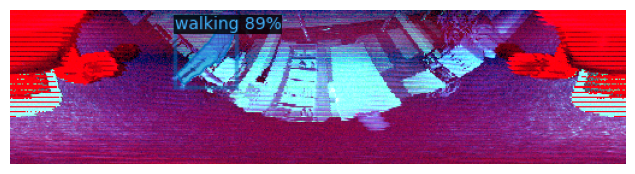

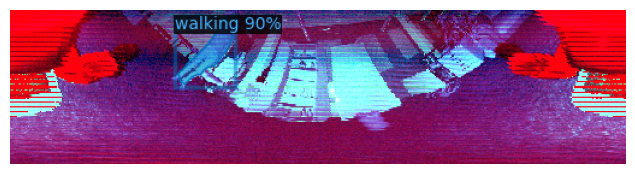

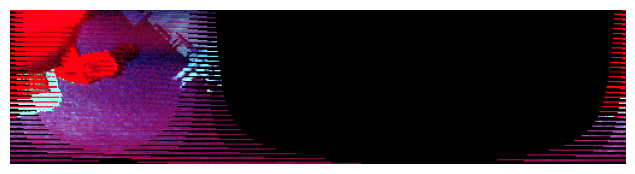

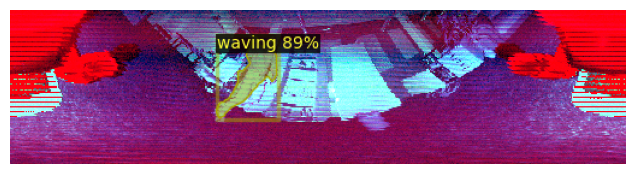

images_detection/3_classes/waving/image_42.png


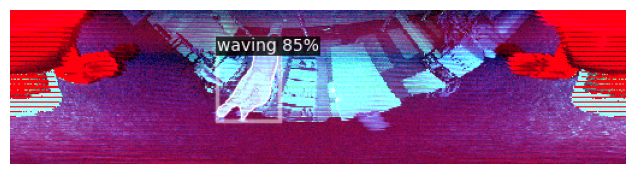

images_detection/3_classes/waving/image_43.png


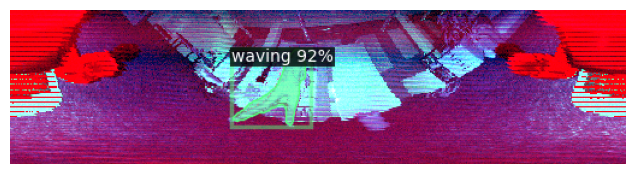

images_detection/3_classes/waving/image_44.png


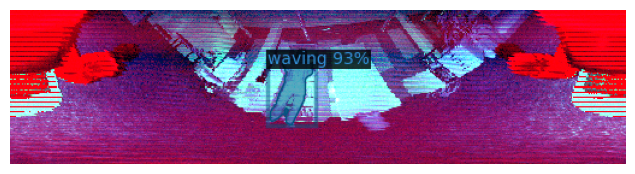

images_detection/3_classes/waving/image_45.png


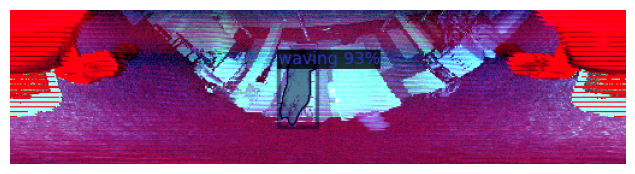

images_detection/3_classes/waving/image_46.png


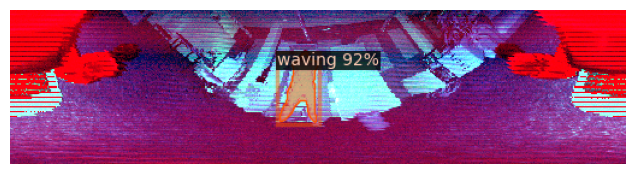

images_detection/3_classes/waving/image_47.png


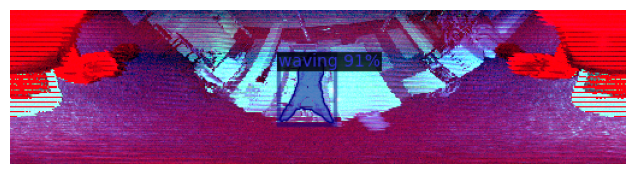

images_detection/3_classes/waving/image_48.png


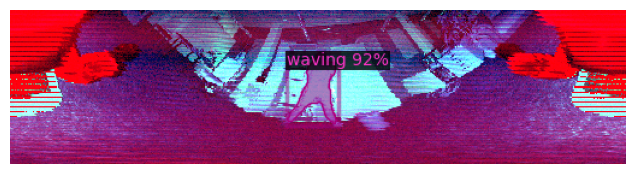

images_detection/3_classes/waving/image_49.png


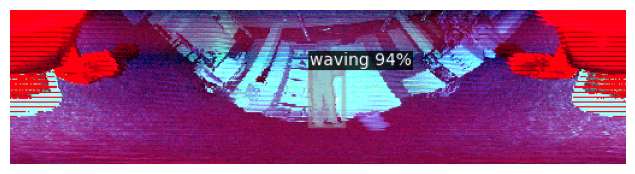

images_detection/3_classes/waving/image_50.png


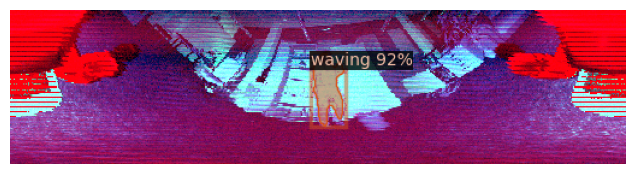

images_detection/3_classes/waving/image_51.png


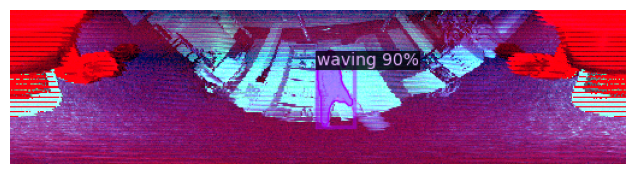

images_detection/3_classes/waving/image_52.png


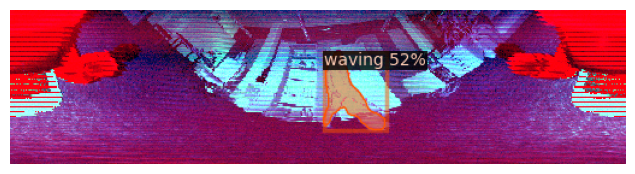

images_detection/3_classes/waving/image_53.png


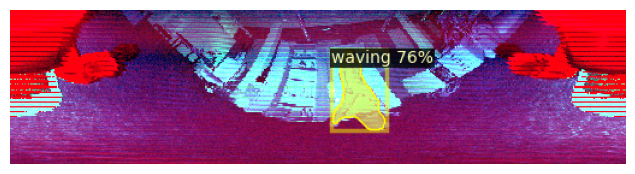

images_detection/3_classes/waving/image_54.png


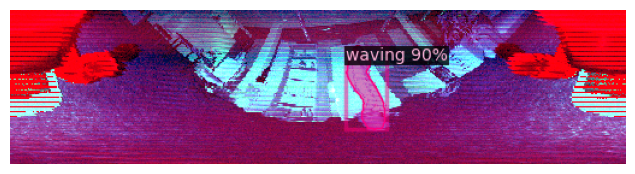

images_detection/3_classes/waving/image_55.png


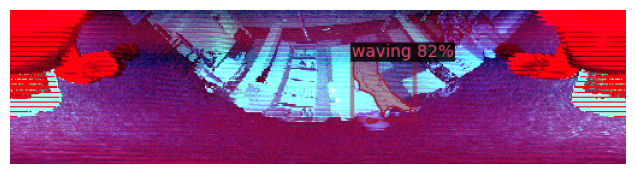

images_detection/3_classes/waving/image_56.png


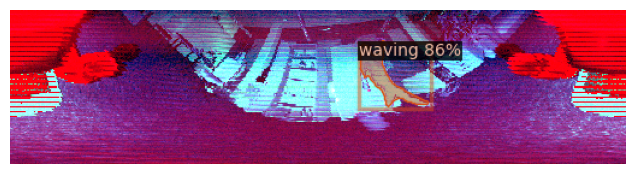

images_detection/3_classes/waving/image_57.png


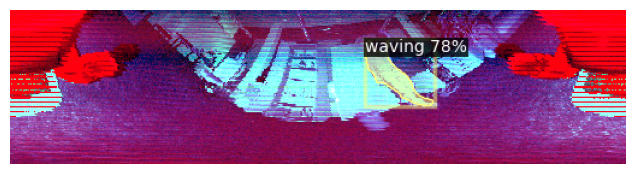

images_detection/3_classes/waving/image_58.png


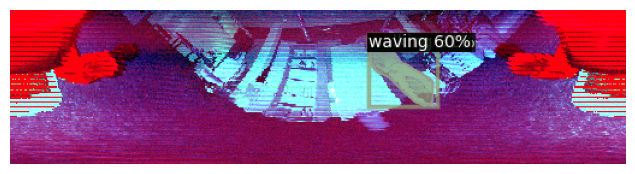

images_detection/3_classes/waving/image_59.png


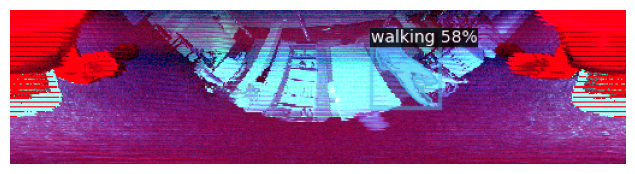

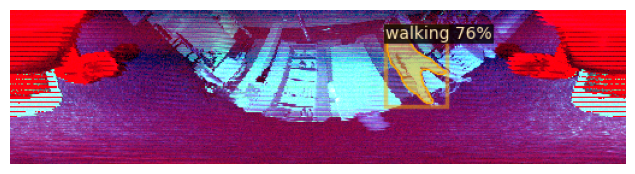

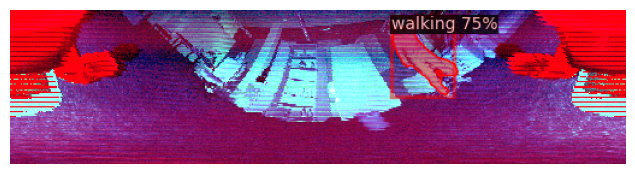

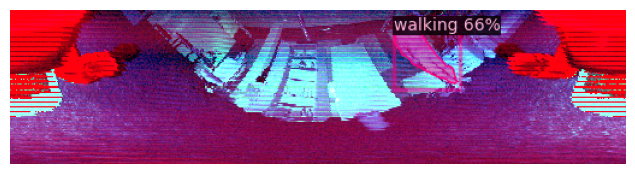

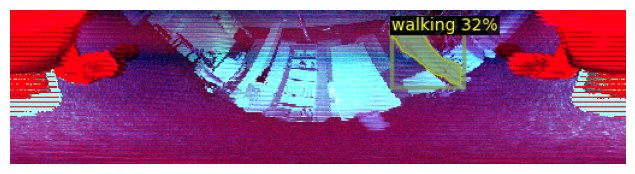

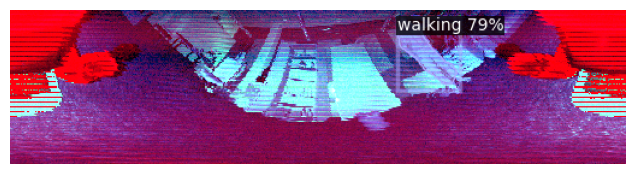

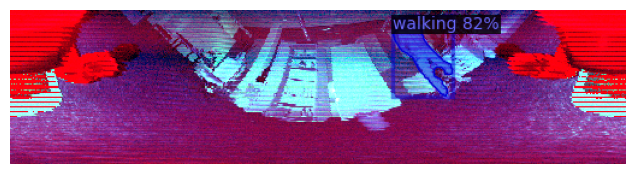

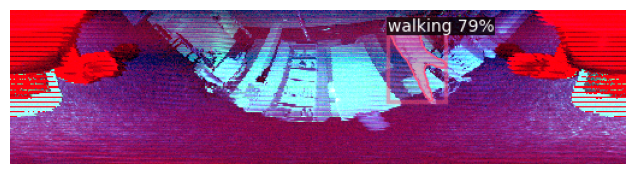

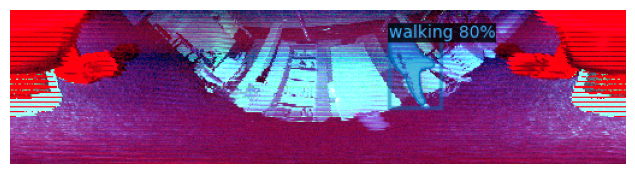

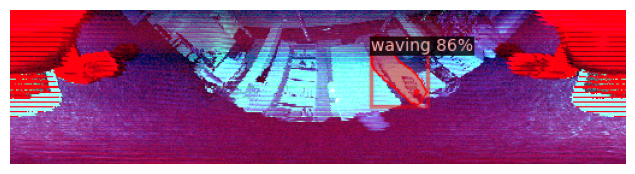

images_detection/3_classes/waving/image_60.png


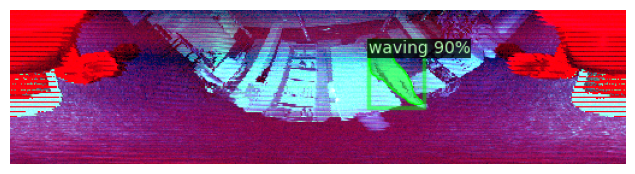

images_detection/3_classes/waving/image_61.png


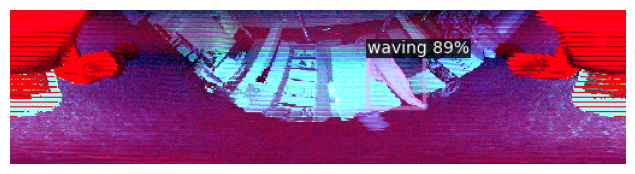

images_detection/3_classes/waving/image_62.png


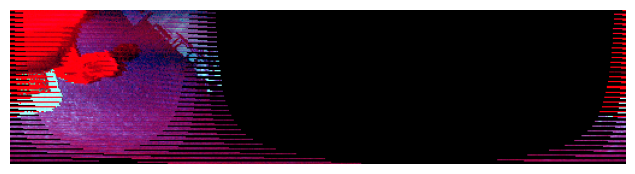

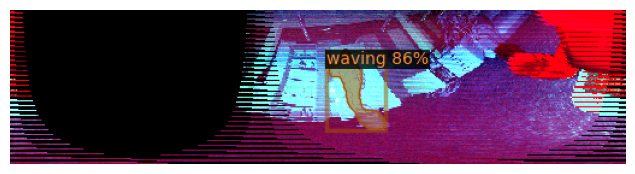

images_detection/3_classes/waving/image_63.png


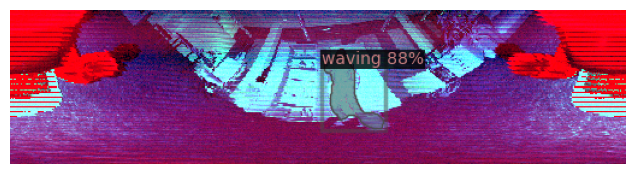

images_detection/3_classes/waving/image_64.png


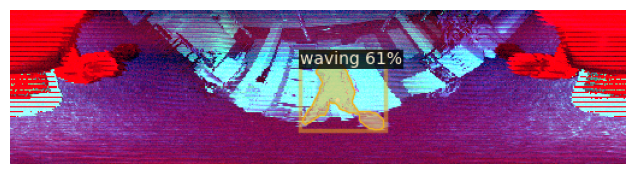

images_detection/3_classes/waving/image_65.png


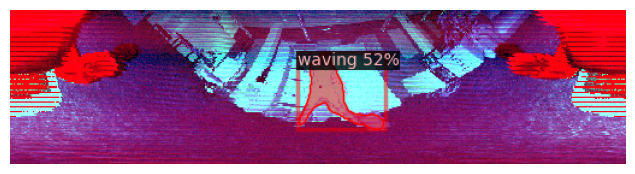

images_detection/3_classes/waving/image_66.png


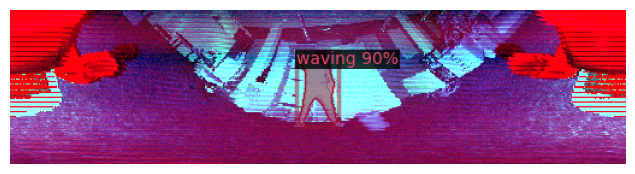

images_detection/3_classes/waving/image_67.png


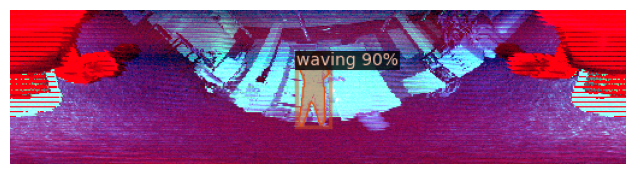

images_detection/3_classes/waving/image_68.png


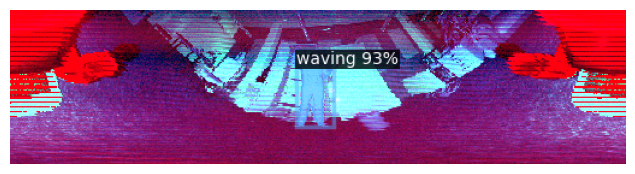

images_detection/3_classes/waving/image_69.png


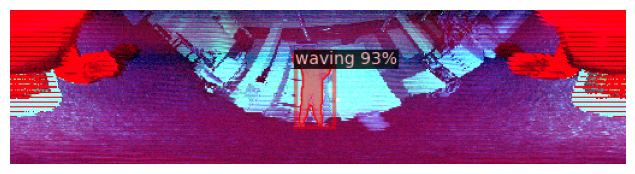

images_detection/3_classes/waving/image_70.png


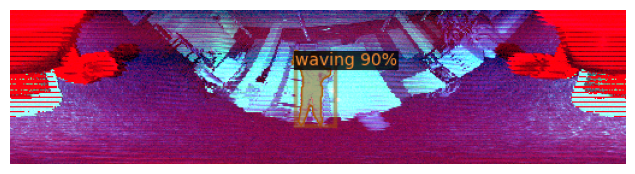

images_detection/3_classes/waving/image_71.png


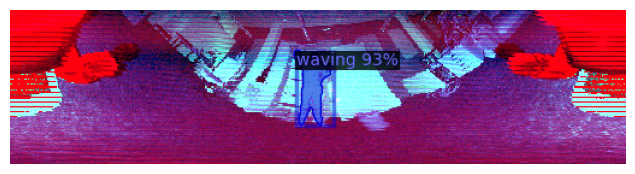

images_detection/3_classes/waving/image_72.png


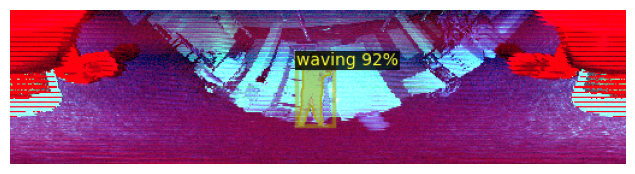

images_detection/3_classes/waving/image_73.png


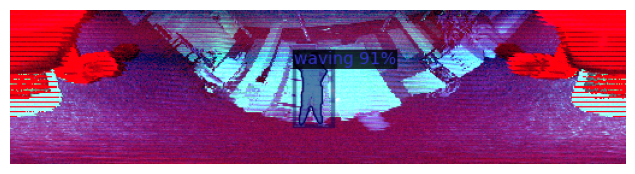

images_detection/3_classes/waving/image_74.png


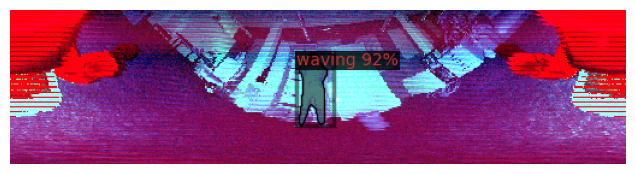

images_detection/3_classes/waving/image_75.png


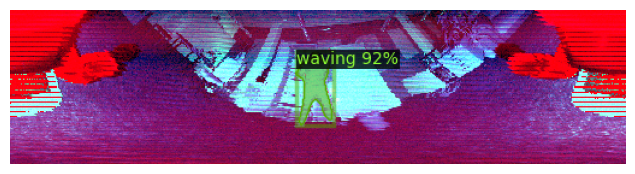

images_detection/3_classes/waving/image_76.png


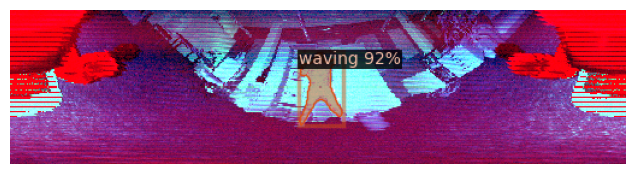

images_detection/3_classes/waving/image_77.png


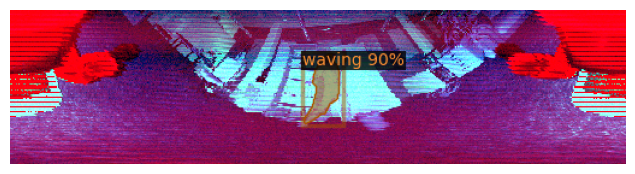

images_detection/3_classes/waving/image_78.png


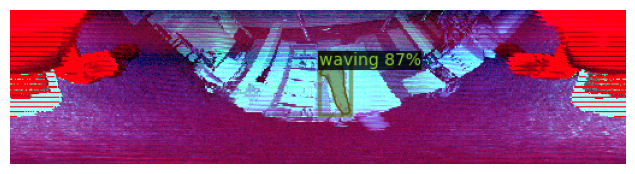

images_detection/3_classes/waving/image_79.png


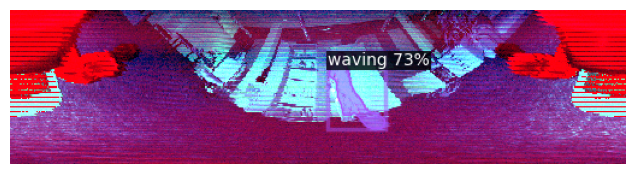

images_detection/3_classes/waving/image_80.png


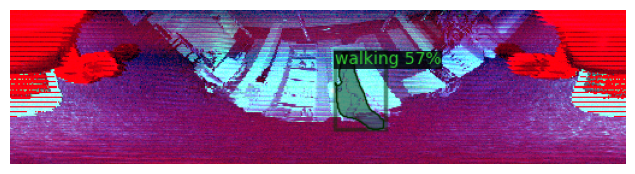

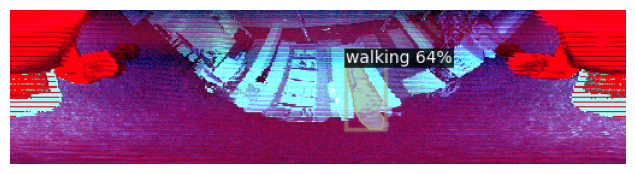

127.74704597473145


In [9]:
clients = {}
for topic in topics:
    image_wait_client = WaitForMessage(f'/ouster/{topic}', Image, r, qos_profile=qos_policy)
    clients.update({topic:image_wait_client})

bridge = CvBridge()

classes = ['sitting', 'walking', 'waving']

starter, ender = torch.cuda.Event(enable_timing=True), torch.cuda.Event(enable_timing=True)
iterations=100
timings=np.zeros((iterations,1))


dir_name = os.path.join('images_detection', '3_classes', 'waving')
#dir_name = os.path.join('images_detection', '1_class')


os.makedirs(dir_name, exist_ok=True)
dir_list = os.listdir(dir_name)
if len(dir_list) == 0:
    last_measurement = -1
else:
    if '.ipynb_checkpoints' in dir_list:
        dir_list.remove('.ipynb_checkpoints')
    last_measurement = max([int(i[6:-4]) for i in dir_list])

j=0

for i in range(iterations):
    
    images = {}
    starter.record()
    for topic in clients:
        img_msg = clients[topic].get_message(timeout_sec=2.0)
        images.update({topic:img_msg})

    ordered_values = np.empty((128, 512, 4), dtype=np.uint8)
    for topic in images:
        cv_image = bridge.imgmsg_to_cv2(images[topic], 'mono8')
        #print(cv_image.shape)
        #cv_image = cv2.resize(cv_image, (512, 64))
        cv_image = cv2.flip(cv_image, 0)
        if topic == "signal_image":
            ordered_values[:,:, 2] = cv_image
        if topic == "range_image":
            ordered_values[:,:, 3] = 255 - cv_image
        if topic == "nearir_image":
            ordered_values[:,:, 0] = cv_image
        if topic == "reflec_image":
            ordered_values[:,:, 1] = cv_image

    output = predictor(ordered_values)
    ender.record()
    # WAIT FOR GPU SYNC
    torch.cuda.synchronize()
    curr_time = starter.elapsed_time(ender)
    timings[i] = curr_time
    v = Visualizer(ordered_values, {"thing_classes": classes})
    #v = Visualizer(ordered_values, {"thing_classes": ['person']})
    #print(output)
    instances = output["instances"]
    #print(instances)
    out = v.draw_instance_predictions(instances[instances.scores > 0.3].to("cpu"))
    plt.figure(figsize=(16, 2))
    plt.axis('off')
    plt.imshow(out.get_image())
    plt.show()
    if (len(instances[instances.scores > 0.5])>0):
        instances = instances[instances.scores > 0.5]
        #print(instances)
        if (len(instances[instances.pred_classes == 2])>0):
            j = j+1
            path = os.path.join(dir_name, f'image_{j+last_measurement}.png') 
            print(path)
        plt.imsave(path, out.get_image())
    
mean_syn = np.sum(timings) / iterations
std_syn = np.std(timings)
print(mean_syn)